# Исследование возможностей применения ML в сфере изобразительного искусства

In [1]:
import pandas as pd
import numpy as np
from pathlib import Path
import cv2
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import random



In [2]:
paintings_links = pd.read_pickle("final_dataframe.pkl")
paintings_links = paintings_links[paintings_links.img_url != "unknown"]
paintings_links = paintings_links[~paintings_links.img_url.duplicated(keep="last")].copy().reset_index().drop(columns="index")

<!-- # идеи и план работ
1. Гистограммы цветов
 1. Показать несколько работ и соответствующие им гистограммы.
 1. Построить средние по художнику гистограммы. Показать соответствующую гистограмму и коллаж из работ художника.
 1. Поиск необычных картин. Показать необычную VS коллаж обычных
 1. Сделать поиск похожих цветовых решений
 1. Построить TSNE для гистограмм художников. Рассмотреть близких по цветовым решениям художников.
 1. Модель для определения художника по гистограмме.
 1. Попробовать разные цветовые схемы, посмотреть в какой из них модель покажет наибольшую точность
 1. Посмотреть "наиболее спорные" работы
 1. Найти работы, которые "приписываются автору". Посмотреть, кого модель посчитает автором с большей вероятностью
1. Кластеризация цветов.
 1. Посчитаем количество оттенков на картину. Найдем самые монотонные и самые разноцветные
 1. Посчитаем среднее число оттенков на художника. Найдем самых монотонных и самых разноцветных.
 1. Посчитаем, насколько часто художник меняет цветовые схемы. Покажем крайности на коллажах
 1. Посчитаем по N основных цветов на картину. 
 1. Визуализируем (treemap) отдельные картины и отдельных художников
 1. Визуализируем (flowchart) изменение во времени цветовых решений в картинах
1. Цветовой круг взять цвета и цветового круга и посмотреть, кто из художников использует его в работе
1. Фантастика.
 1. С помощью нейросети узнаем какие сущности изображены на картине.
 1. Используем tf-idf, смотрим о чем пишут авторы -->

In [3]:
paintings_links.head()

,artist_name,live_from,live_to,pictures_count,picture_name,img_url,img_path
0,Иван Константинович Айвазовский,1817,1900,516,Девятый вал,https://sr.gallerix.ru/_EX/1016087178/71308039...,data/Иван Константинович Айвазовский/0_Девятый...
1,Иван Константинович Айвазовский,1817,1900,516,Лунная дорожка,https://sr.gallerix.ru/_EX/1819898631/33996887...,data/Иван Константинович Айвазовский/1_Лунная ...
2,Иван Константинович Айвазовский,1817,1900,516,Штиль 1885 42х62,https://sr.gallerix.ru/_EX/1819898631/52061157...,data/Иван Константинович Айвазовский/2_Штиль 1...
3,Иван Константинович Айвазовский,1817,1900,516,Закат 1866 46х61,https://sr.gallerix.ru/_EX/1819898631/31920471...,data/Иван Константинович Айвазовский/3_Закат 1...
4,Иван Константинович Айвазовский,1817,1900,516,Волна 1889 304х505,https://sr.gallerix.ru/_EX/1819898631/59644470...,data/Иван Константинович Айвазовский/4_Волна 1...


In [2057]:
paintings_links.artist_name.nunique()

224

In [4]:
# прочитать с диска массив пикселей картины
def load_image_by_index(i):
    image_path = paintings_links.iloc[i].img_path
    img = cv2.imdecode(np.fromfile(str(Path.cwd()/image_path), np.uint8), cv2.IMREAD_UNCHANGED)
    return img    

In [43]:
# функция для отображения работ по индексу
def plot_works_by_index(lst, constrained_layout=True):
    rows_count = (len(lst)-1)//3 + 1

    fig, axs = plt.subplots(rows_count,3, figsize=(15,10), constrained_layout=constrained_layout)
    axs = axs.flatten()
    for i, img_index in enumerate(lst):
            axs[i].imshow(cv2.cvtColor(load_image_by_index(img_index), cv2.COLOR_BGR2RGB))
            axs[i].axis('off')
            axs[i].title.set_text(paintings_links.iloc[img_index].picture_name)
    for p in axs:
        p.axis('off')
    #     p.set_aspect("auto")
    plt.tight_layout(w_pad = 1, h_pad=1)
    # plt.subplots_adjust(wspace=0.01,hspace=0.01, top =1)


In [6]:
# посчитать гистограммы по картинке
def get_hist_data_by_index(img_index):
    bin_div = 5
    img = load_image_by_index(img_index)
    b, bins=  np.histogram(img[:,:,0], bins=255//bin_div, range=(0,255), density=True)
    g = np.histogram(img[:,:,1], bins=255//bin_div, range=(0,255), density=True)[0]
    r = np.histogram(img[:,:,2], bins=255//bin_div, range=(0,255), density=True)[0]
    return bins, r, g, b

In [441]:
# строим картину и рядышком с ней гистограммы
def plot_image_by_index(img_index, height=6):
    img = load_image_by_index(img_index)
    fig = plt.figure(constrained_layout=False)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB),aspect = 'equal')
    plt.axis('off')
    
    plt.title("{} - {}".format(paintings_links.iloc[img_index].artist_name, 
                                 paintings_links.iloc[img_index].picture_name),ha= "left")
    plt.show()

In [101]:
# строим картину и рядышком с ней гистограммы
def plot_image_with_hist_by_index(img_index, height=6):
    bins, r, g, b = get_hist_data_by_index(img_index)
    img = load_image_by_index(img_index)
    fig = plt.figure(constrained_layout=True)

    if img.shape[0] < img.shape[1]:
        width_ratios = [3,1]
    else:
        width_ratios = [1,1]
        
    gs = GridSpec(3, 2, figure=fig, 
                  width_ratios = [3,1]
                 )
    ax_img = fig.add_subplot(gs[:,0])

    ax_r = fig.add_subplot(gs[0, 1])
    ax_g = fig.add_subplot(gs[1, 1], sharey=ax_r)
    ax_b = fig.add_subplot(gs[2, 1], sharey=ax_r)

    ax_img.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB),aspect = 'equal')
    ax_img.axis('off')
    
    ax_r.bar(bins[:-1], r, width = 5, color='red',alpha=0.7)
    ax_g.bar(bins[:-1], g, width = 5, color='green',alpha=0.7)
    ax_b.bar(bins[:-1], b, width = 5, color='blue',alpha=0.7)

    ax_r.axes.get_xaxis().set_ticks([])
    ax_r.axes.get_yaxis().set_ticks([])
    ax_g.axes.get_xaxis().set_ticks([])
    ax_g.axes.get_yaxis().set_ticks([])
    ax_b.axes.get_xaxis().set_ticks([])
    ax_b.axes.get_yaxis().set_ticks([])
    fig.suptitle("{} - {}".format(paintings_links.iloc[img_index].artist_name, 
                                 paintings_links.iloc[img_index].picture_name),ha= "left")
    
    fig.set_figheight(height)
    plt.axis('tight')
    if img.shape[0] < img.shape[1]:
        fig.set_figwidth(img.shape[1] *height / img.shape[0] *1.25)
    else:
        fig.set_figwidth(img.shape[1] *height / img.shape[0] *1.5)
    plt.show()

# Посмотрим на случайно выбраные работы

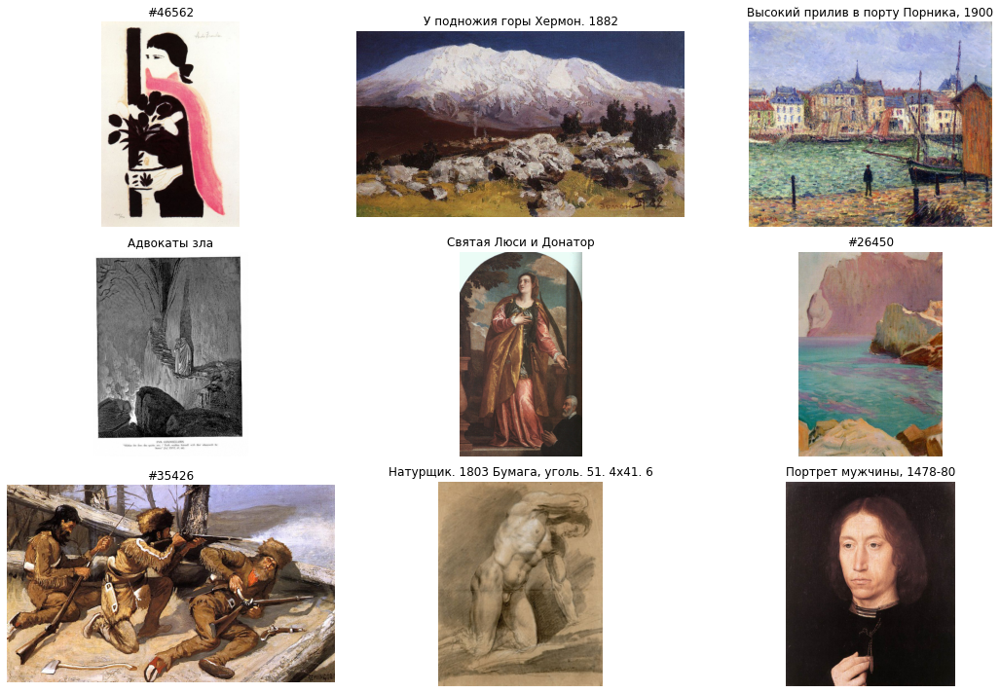

In [17]:
plot_works_by_index(np.random.choice(paintings_links.index.values, replace=False, size=9))

# На вид картины имеют очень разные цветовые решения
## Попробуем охарактеризовать работы с помощью RGB гистограмм

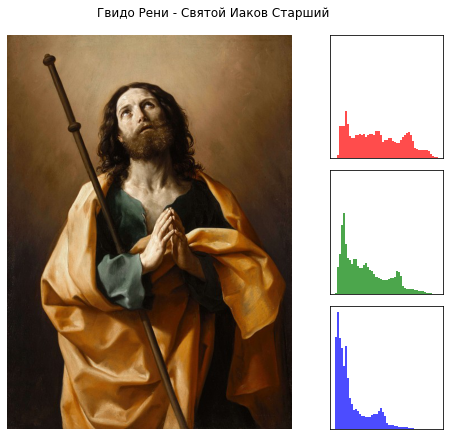

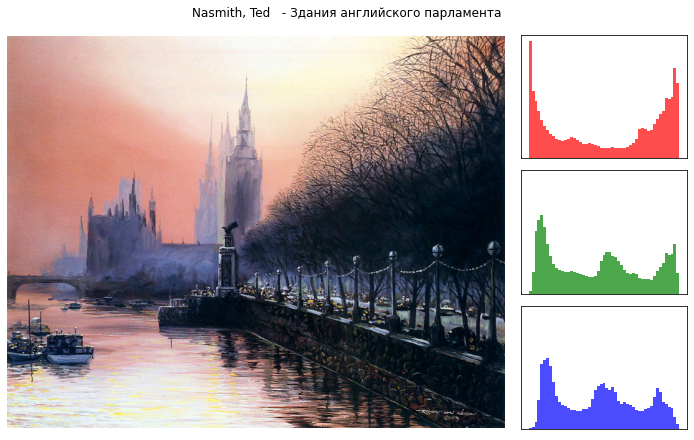

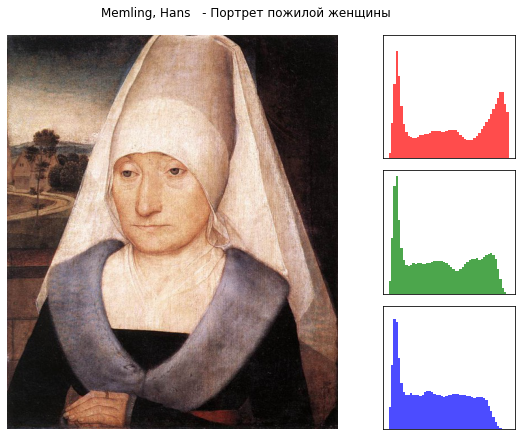

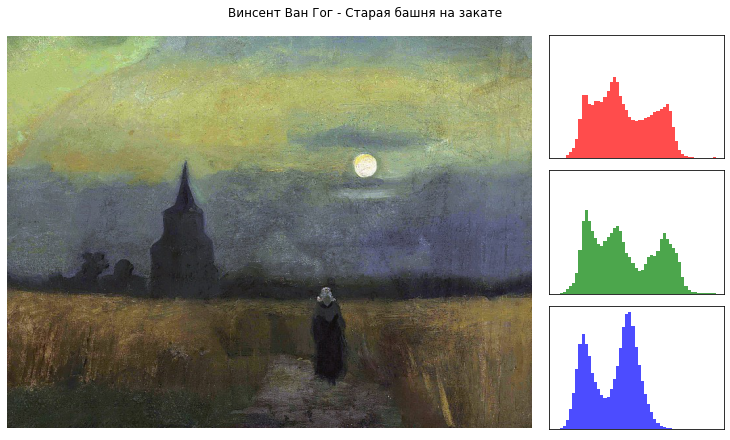

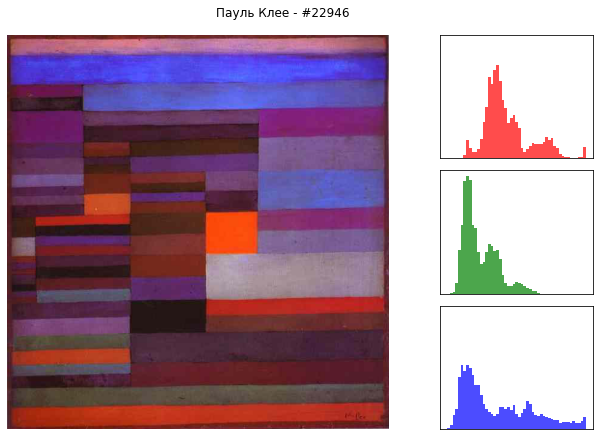

In [43]:
for i in np.random.choice(paintings_links.index.values, replace=False, size=5):
    plot_image_with_hist_by_index(i)

# На первый взгляд кажется, что гистограммы создают некий уникальный отпечаток картины. 

## Соберем датасет

In [8]:
# пробежимся по всем картинкам в нашей базе, посчитаем гистаграммы и соберем из этого датасет
res = []
error = []
for img_index in tqdm(range(paintings_links.shape[0])):
    try:
        bins, r, g, b = get_hist_data_by_index(img_index)
        res.append(np.hstack([r,g,b]))
    except:
        res.append(np.zeros(153,))
        error.append(img_index)
        
np_res = np.vstack(res)
# сохраним для дальнейшего использования
pd.DataFrame(np_res).to_pickle("histograms.pkl")
histograms = pd.read_pickle("histograms.pkl")

In [19]:
pd.DataFrame(np_res).to_pickle("histograms.pkl")
pd.Series(error).to_pickle("bad_images.pkl") # часть изображений не годится для анализа, так как они в оттенках серого

In [23]:
bad_images = pd.read_pickle("bad_images.pkl")

In [25]:
histograms = pd.read_pickle("histograms.pkl")

## Используем one_class_svm чтобы найти необычные картины

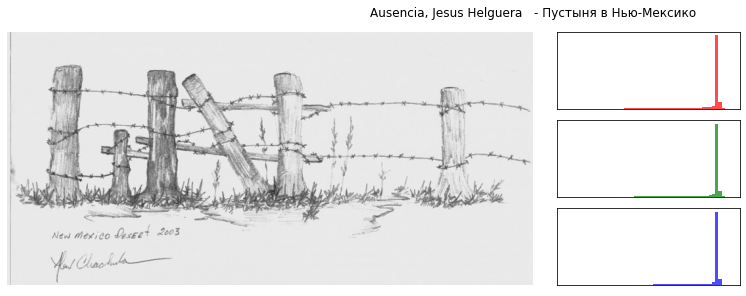

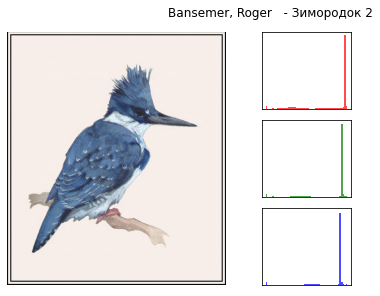

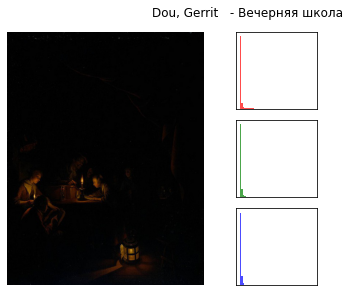

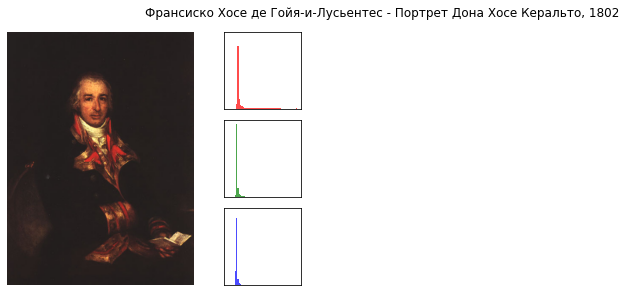

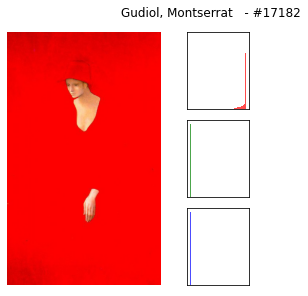

...

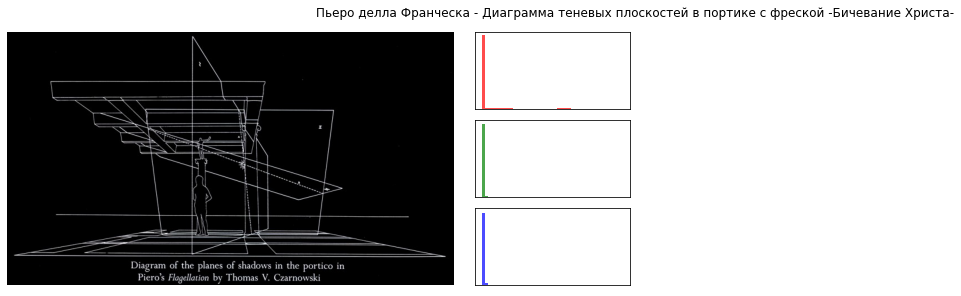

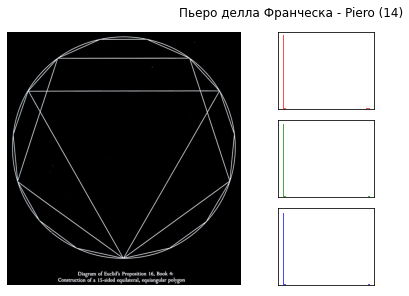

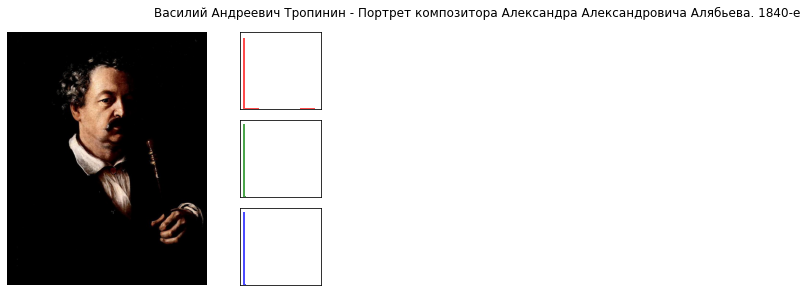

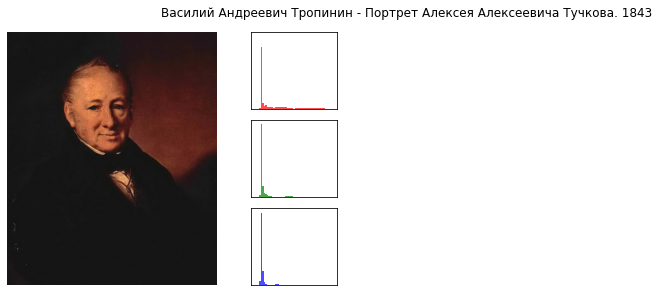

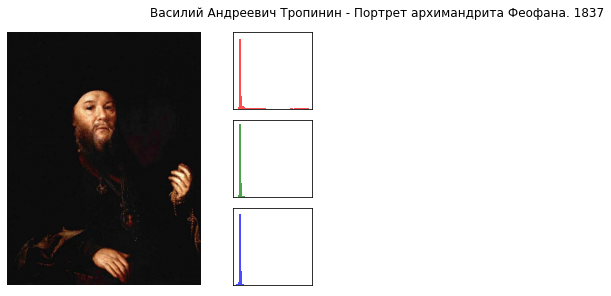

Wall time: 10.3 s


In [112]:
%%time
# обучим модельку. на вход она ожидает от нас предполагаемую долю аномалий. пусть будет 10 аномалий на весь датасет
one_class_svm = OneClassSVM(nu=10 / histograms.shape[0], gamma='auto')
one_class_svm.fit(histograms[~histograms.index.isin(bad_images)])
# выделим аномалии
svm_outliers = one_class_svm.predict(histograms)
svm_outliers = np.array([1 if label == -1 else 0 for label in svm_outliers])
# и отобразим их
uncommon_images = paintings_links[(svm_outliers ==1) & (~histograms.index.isin(bad_images))].index.values
for i in uncommon_images:
    plot_image_with_hist_by_index(i,4)

## Сделаем инструмент для поиска похожих цветовых решений

In [147]:
# сделаем инструмент, который поможет найти похожие по цветовой гамме картины
from scipy import spatial
def find_closest(target_id,n=5):
    distance_vector = np.apply_along_axis(spatial.distance.cosine,
                        arr=histograms,
                       axis=1,
                       v=histograms.values[target_id])
    return np.argsort(distance_vector)[:n]

### похожее на Девятый вал Айвазовского

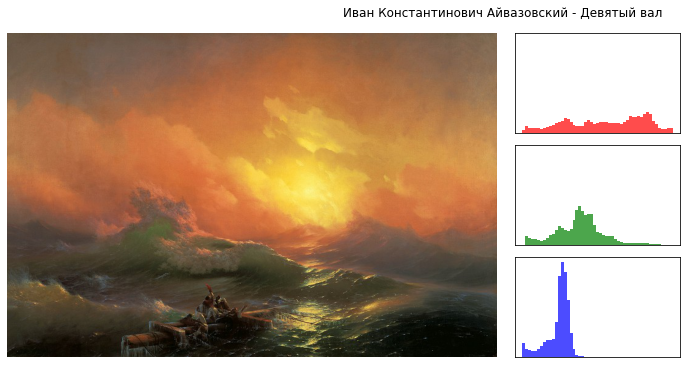

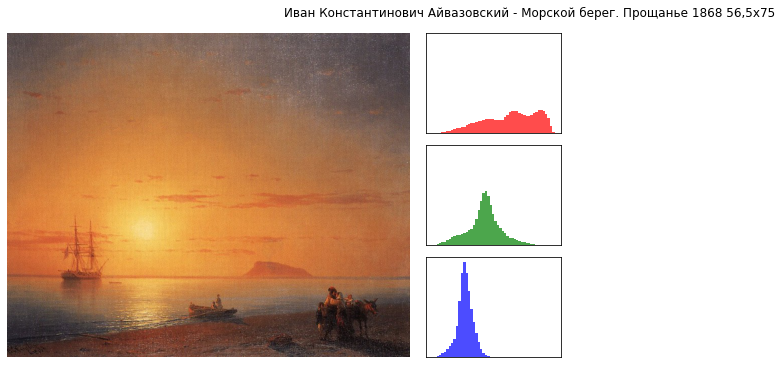

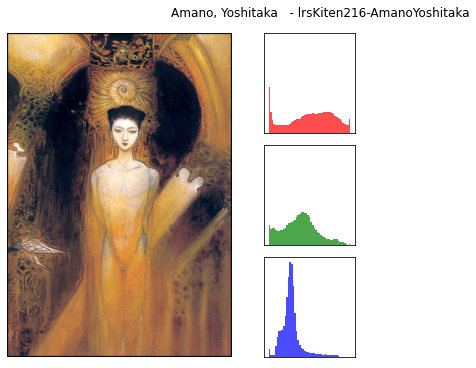

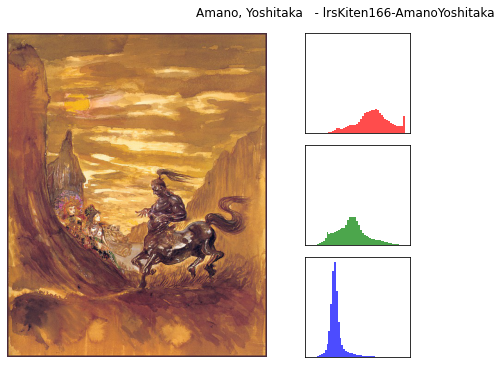

In [150]:
for i in (find_closest(0,4)):
    plot_image_with_hist_by_index(i,5)

### похожее на "Цветущий миндаль" Ван Гога

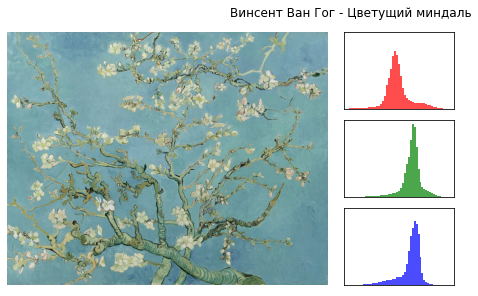

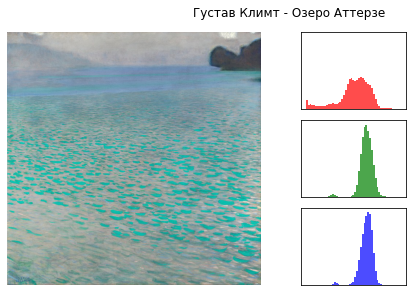

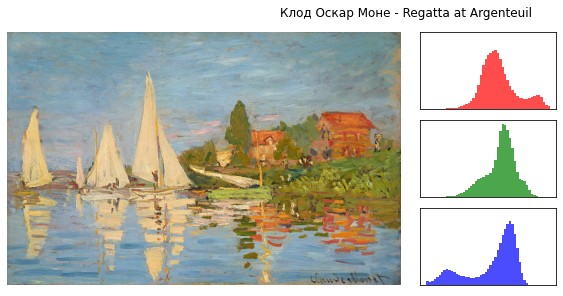

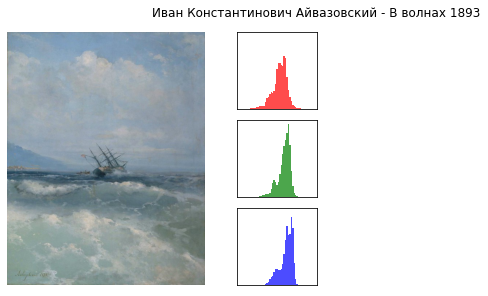

In [159]:
for i in (find_closest(15679,4)):
    plot_image_with_hist_by_index(i,4)

### похожее на ярко-красную даму, выделенную как аномалия

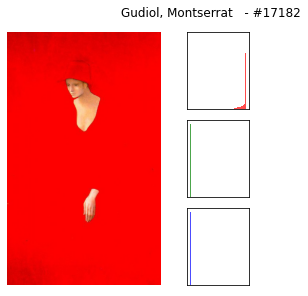

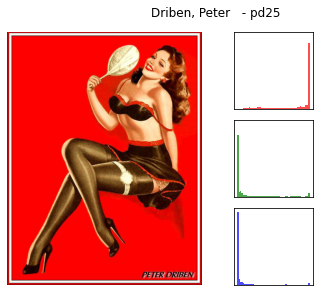

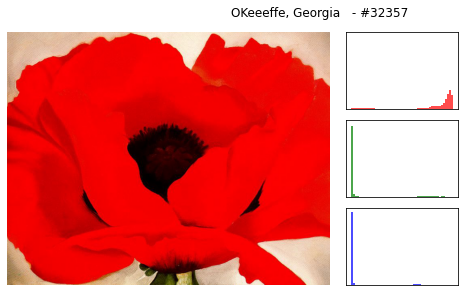

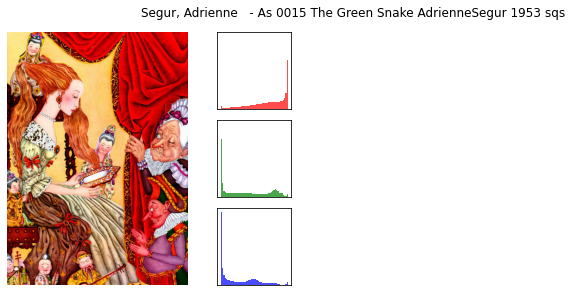

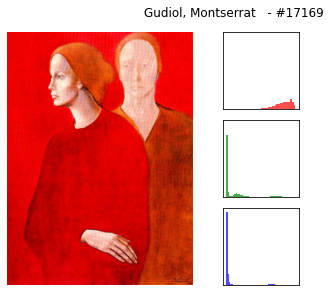

In [160]:
for i in (find_closest(17208,5)):
    plot_image_with_hist_by_index(i,4)

# можем ли мы сделать модель, которая определит художника по гистограмме?

In [170]:
df = histograms.copy()
df["target"] = paintings_links.artist_name
df = df[~df.index.isin(bad_images)]

In [2100]:
%%time
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegressionCV, LogisticRegression
from xgboost import XGBClassifier
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(df.target)
X_train, X_test, y_train, y_test = train_test_split(df.drop(columns="target"), 
                                                    le.transform(df.target), 
                                                    test_size=.2,
                                                    stratify = le.transform(df.target)
                                        
                                           )
xgb = XGBClassifier()
# xgb = LogisticRegressionCV(cv=2)
xgb.fit(X_train, y_train)

Wall time: 13h 35min 5s


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='multi:softprob', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [195]:
classification_report(y_test, xgb.predict(X_test), labels=None, target_names=None, output_dict=True).get("macro avg")

c:\users\asus\miniconda3\envs\otus_ml\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'precision': 0.14215276773245558,
 'recall': 0.09990963146497175,
 'f1-score': 0.08946147278018535,
 'support': 9818}

In [ ]:
# качество получилось не очень. надо попробовать использовать гистограммы в других цветовых шкалах

In [226]:
list_of_color_spaces = [i for i in dir(cv2) if "COLOR_BGR" in i if len(i)==len("COLOR_BGR2YUV")]

In [245]:
def get_hist_data_by_index_and_colorspace(bgr_img, colorspace):
    bin_div = 5
#     img = load_image_by_index(img_index)
    img_cvt = cv2.cvtColor(bgr_img, getattr(cv2, colorspace))
    c1, bins =  np.histogram(img_cvt[:,:,0], bins=255//bin_div, range=(0,255), density=True)
    c2 = np.histogram(img_cvt[:,:,1], bins=255//bin_div, range=(0,255), density=True)[0]
    c3 = np.histogram(img_cvt[:,:,2], bins=255//bin_div, range=(0,255), density=True)[0]
    return bins, c1, c2, c3

In [271]:
all_res = {}
all_errors = {}
for colorspace in list_of_color_spaces:
    all_res[colorspace] =[]
    all_errors[colorspace] =[]
for img_index in tqdm(range(paintings_links.shape[0]) ):
    
    for colorspace in list_of_color_spaces:
        try:
            bgr_img = load_image_by_index(img_index)
            bins, c1, c2, c3 = get_hist_data_by_index_and_colorspace(bgr_img, colorspace)
            all_res[colorspace].append(np.hstack([c1, c2, c3]))
        except:
            all_res[colorspace].append(np.zeros(153,))
            all_errors[colorspace].append(img_index)
#             print("error occured")
all_res_np = {}
for colorspace in list_of_color_spaces:  
    all_res_np[colorspace] = np.vstack(all_res[colorspace])

In [272]:
for k in all_errors.keys():
    print("{} - {}".format(k,len(all_errors.get(k))))

COLOR_BGR2HLS - 68
COLOR_BGR2HSV - 68
COLOR_BGR2LAB - 68
COLOR_BGR2LUV - 68
COLOR_BGR2Lab - 68
COLOR_BGR2Luv - 68
COLOR_BGR2RGB - 68
COLOR_BGR2XYZ - 68
COLOR_BGR2YUV - 68


In [273]:
for colorspace in tqdm(list_of_color_spaces):
    pd.DataFrame(all_res_np.get(colorspace)).to_pickle("{}.pkl".format(colorspace))

In [274]:
res = []
for colorspace in tqdm(list_of_color_spaces):
    temp_df = pd.DataFrame(all_res_np.get(colorspace))
    temp_x_train =   temp_df[temp_df.index.isin(X_train.index.values)]
    temp_x_test =   temp_df[temp_df.index.isin(X_test.index.values)]
#     xgb = LogisticRegressionCV(cv=2)
    xgb=XGBClassifier()
    xgb.fit(temp_x_train, y_train)
    current_res = classification_report(y_test, xgb.predict(temp_x_test), labels=None, target_names=None, output_dict=True).get("macro avg")
    current_res["colorspace"] = colorspace
    res.append(current_res)

c:\users\asus\miniconda3\envs\otus_ml\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [277]:
pd.DataFrame(res).sort_values(by="f1-score")

,precision,recall,f1-score,support,colorspace
8,0.001329,0.003663,0.001059,9818,COLOR_BGR2YUV
6,0.003229,0.004689,0.001849,9818,COLOR_BGR2RGB
1,0.003026,0.004131,0.001868,9818,COLOR_BGR2HSV
7,0.002909,0.004578,0.001934,9818,COLOR_BGR2XYZ
0,0.003545,0.004434,0.001941,9818,COLOR_BGR2HLS
2,0.003922,0.004784,0.002098,9818,COLOR_BGR2LAB
4,0.003922,0.004784,0.002098,9818,COLOR_BGR2Lab
3,0.005118,0.004836,0.002434,9818,COLOR_BGR2LUV
5,0.005118,0.004836,0.002434,9818,COLOR_BGR2Luv


### Моделирование показало что цветовая схема LUV превосходит аналоги в разы.
### в дальнейшем будем использовать именно ее

Нашел интересную справку на тему того почему это хорошо работает.
There are two reasons we might use non-RGB colorspaces, including LUV, in computer vision. The first reason is that differences in RGB space do not correspond well to perceived differences in color. That is, two colors can be close in RGB space but appear very different to humans and vice versa. The second reason (and I would say the more important one for object detection) is that spaces like LUV decouple the "color" (chromaticity, the UV part) and "lightness" (luminance, the L part) of color. Thus in object detection, it is common to match objects just based on the UV part, which gives invariance to changes in lighting condition.

In [281]:
%%time
temp_df = pd.DataFrame(all_res_np.get("COLOR_BGR2LUV"))
temp_x_train =   temp_df[temp_df.index.isin(X_train.index.values)]
temp_x_test =   temp_df[temp_df.index.isin(X_test.index.values)]
xgb=XGBClassifier()
xgb.fit(temp_x_train, y_train)
current_res = classification_report(y_test, xgb.predict(temp_x_test), labels=None, target_names=None, output_dict=True)

Wall time: 1h 54min 48s


In [305]:
model_stat = pd.DataFrame(current_res).drop(columns=["accuracy","macro avg","weighted avg"]).T
model_stat["artist_name"] = le.classes_
model_stat.sort_values(by="f1-score").tail(10)

,precision,recall,f1-score,support,artist_name
159,0.042553,0.019417,0.026667,103.0,Илья Ефимович Репин
201,0.055556,0.020000,0.029412,50.0,Уильям Меррит Чейз
7,0.071429,0.022222,0.033898,45.0,"Bonnard, Pierre"
136,0.035461,0.035211,0.035336,142.0,Джил Элвгрен
149,0.100000,0.021739,0.035714,46.0,Жан Огюст Доминик Энгр
190,0.022814,0.224066,0.041411,241.0,Пьер Огюст Ренуар
100,0.100000,0.028571,0.044444,35.0,Альберт Бирштадт
212,0.250000,0.032258,0.057143,31.0,Ханс Зацка
166,0.030396,0.518797,0.057428,266.0,Клод Оскар Моне
24,0.250000,0.037037,0.064516,27.0,"Girotto, Walter"


In [356]:
# Посмотрим на Моне (Вальтера джиротто раскритиковала супруга)

In [375]:
mone_predict = xgb.predict_proba(temp_x_test[(paintings_links.index.isin(X_test.index.values)) & 
                (paintings_links.artist_name == "Клод Оскар Моне")
               ])
pd.merge(
pd.Series(le.classes_).rename("name"),
    pd.Series(mone_predict.argsort(axis=1)[:,-2:].flatten()).value_counts().head().rename("counts"),
    left_index=True,
    right_index=True
).sort_values(by="counts", ascending=False)

c:\users\asus\miniconda3\envs\otus_ml\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


,name,counts
166,Клод Оскар Моне,186
190,Пьер Огюст Ренуар,171
124,Винсент Ван Гог,25
186,Питер Пауль Рубенс,19
130,Гюстав Доре,17


In [396]:
# ого! путаем Моне, Ренуара и Ван Гога!
# очень интересно, какие из работ Моне похожи на Ван Гога?

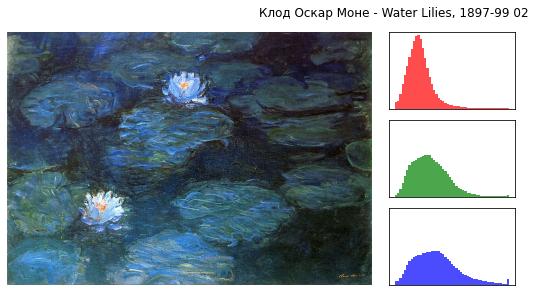

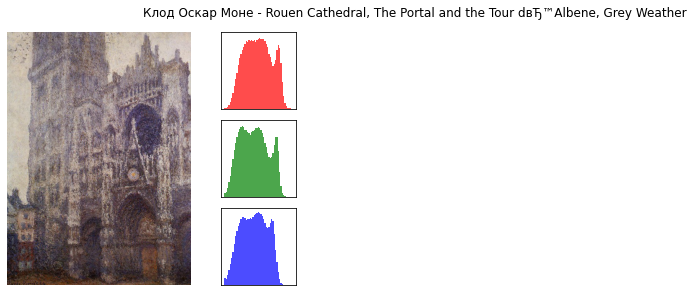

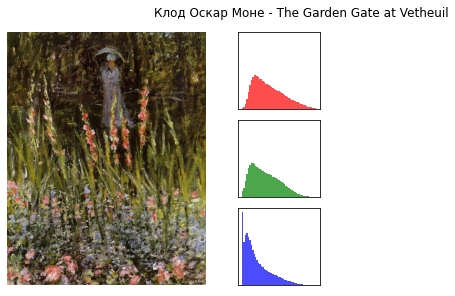

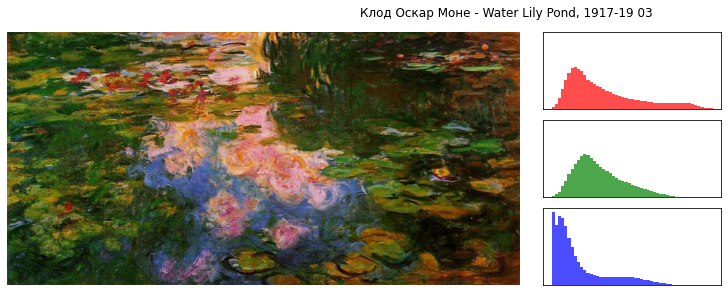

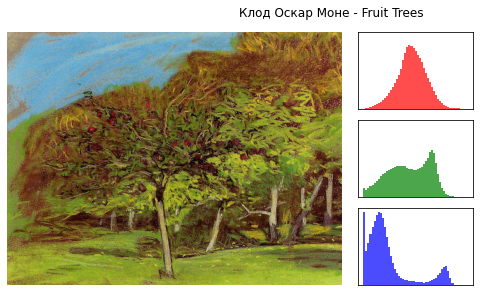

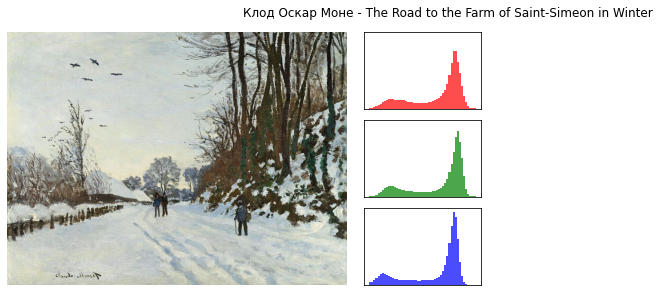

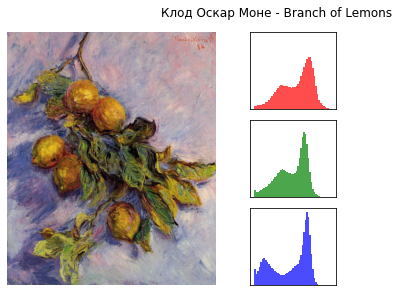

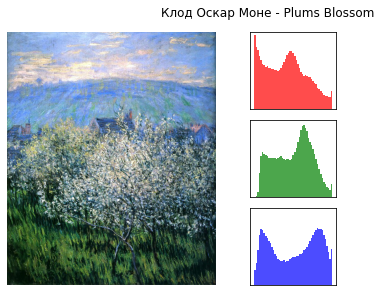

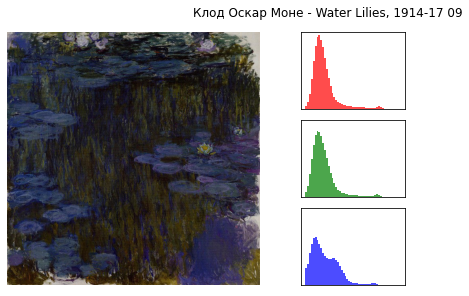

In [460]:
_ = paintings_links[(paintings_links.index.isin(X_test.index.values)) & 
                (paintings_links.artist_name == "Клод Оскар Моне")].reset_index().rename(columns={"index":"original_index"})
_ = _[_.index.isin(np.argwhere((mone_predict.argsort(axis=1)[:,-1:]==124).any(axis=1)).flatten())]
for i in _.original_index.values[:]:
    plot_image_with_hist_by_index(i,4)

In [420]:
def find_closest_luv(target_id,n=5):
    _ = all_res_np.get("COLOR_BGR2LUV")
    distance_vector = np.apply_along_axis(spatial.distance.cosine,
                        arr=_,
                       axis=1,
                       v=_[target_id])
    return np.argsort(distance_vector)[:n]

#### Попробуем понять, какие схожие работы есть у Ван Гога

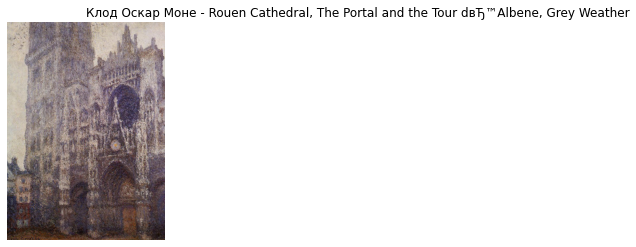

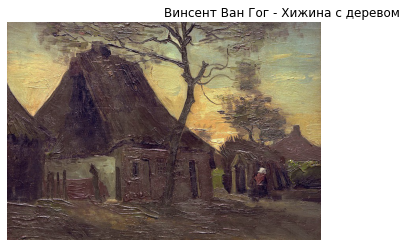

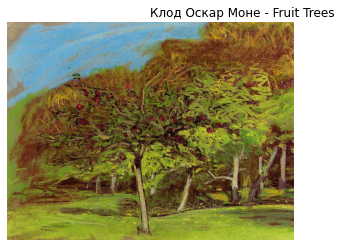

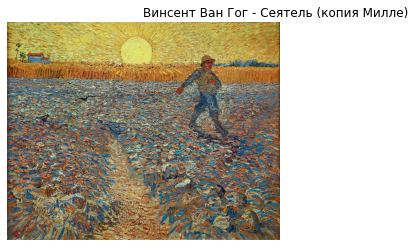

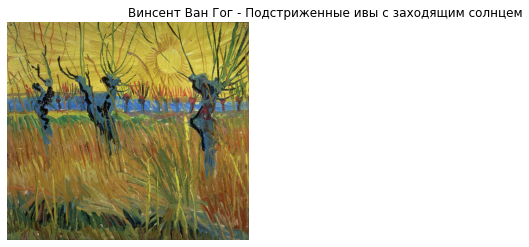

...

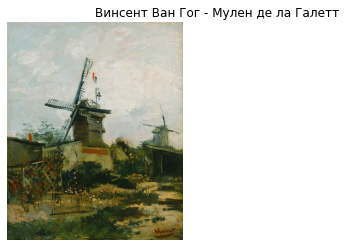

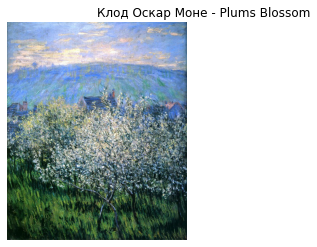

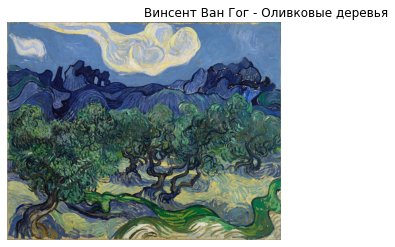

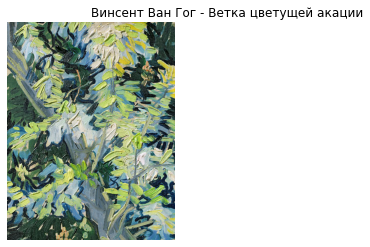

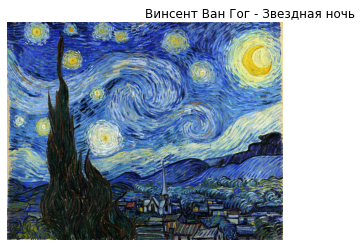

In [464]:
vg_paintings = paintings_links[paintings_links.artist_name == "Винсент Ван Гог"].index.values
for target_index in _.original_index.values[:]:
    closest = find_closest_luv(target_index,20)
    if set(vg_paintings).intersection(set(closest)):
        print()
        print()
        print()
        for i in closest:
            if target_index == i or i in vg_paintings:
                plot_image_by_index(i)

In [2059]:
# я показал свою работу жене и она сказала мне, что самое главное картине - композиция.
# а гистограммы не могут полностью раскрыть композицию

### Попробуем анализировать картины так, как это делают художники 
#### В качестве ориенира используем цветовой круг Иттена.

<img src="colorwheel.png" width="250" height="250">

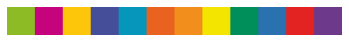

In [552]:
wheel = cv2.imdecode(np.fromfile(str(Path.cwd()/"colorwheel_full.png"), np.uint8), cv2.IMREAD_UNCHANGED)
v, c = np.unique(wheel[:,:,:3].reshape(-1,3), axis=0,return_counts=True)
wheel_colors = v[np.argsort(c)][-13:][:-1]
fig = plt.figure(constrained_layout=False)
plt.imshow(cv2.cvtColor(np.hstack( [np.tile(c, (50,50,1)) for c in wheel_colors]), cv2.COLOR_BGR2RGB),aspect = 'equal')
plt.axis('off');

In [534]:
# порядок цветов рандомный. приведем к изначальному

(12, 3)

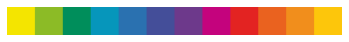

In [573]:
# против часовой
wheel_colors2 = wheel_colors[np.argsort(cv2.cvtColor(wheel_colors.reshape(1,12,3), cv2.COLOR_BGR2HSV)[:,:,0])].reshape(12,3)
wheel_colors2  = np.vstack([wheel_colors2[-8:], wheel_colors2[:-8]])
fig = plt.figure(constrained_layout=False)
plt.imshow(cv2.cvtColor(np.hstack( [np.tile(c, (50,50,1)) for c in wheel_colors2]), cv2.COLOR_BGR2RGB),aspect = 'equal')
plt.axis('off');

In [581]:
# переведем в LUV
wheel_colors_luv = cv2.cvtColor(wheel_colors2.reshape(12,1,3), cv2.COLOR_BGR2LUV).reshape(12,3)

In [644]:
from sklearn.metrics.pairwise import cosine_distances,euclidean_distances
def get_image_colors(image_index):
    luv_img = cv2.cvtColor(load_image_by_index(image_index), cv2.COLOR_BGR2LUV)
    closest_colors = np.argmin(euclidean_distances(luv_img.reshape(-1,3),wheel_colors_luv),axis=1)
    v, c = np.unique(closest_colors,return_counts=True)
    c = c / c.sum()
    return v, c

In [658]:
def plot_circle_colors(image_index):
    v, c = get_image_colors(image_index)
    _ = []
    for i, vi in enumerate(v):
        _.append(np.tile(wheel_colors2[vi], (150,int(c[i]*1000),1)))
    fig = plt.figure(constrained_layout=False)
    plt.imshow(cv2.cvtColor(np.hstack(_), cv2.COLOR_BGR2RGB),aspect = 'equal')
    plt.axis('off');

In [676]:
def plot_color_areas(image_index):
    luv_img = cv2.cvtColor(load_image_by_index(image_index), cv2.COLOR_BGR2LUV)
    closest_colors = np.argmin(euclidean_distances(luv_img.reshape(-1,3),wheel_colors_luv),axis=1)
    wheel_colors2[closest_colors].reshape(luv_img.shape)
    fig = plt.figure(constrained_layout=False)
    plt.imshow(cv2.cvtColor(wheel_colors2[closest_colors].reshape(luv_img.shape), cv2.COLOR_BGR2RGB),aspect = 'equal')
    plt.axis('off');
    # v, c = np.unique(closest_colors,return_counts=True)
    # c = c / c.sum()

In [787]:
def plot_composition_analysis(image_index):
    img = load_image_by_index(image_index)
    luv_img = cv2.cvtColor(load_image_by_index(image_index), cv2.COLOR_BGR2LUV)
    closest_colors = np.argmin(euclidean_distances(luv_img.reshape(-1,3),wheel_colors_luv),axis=1)
    wheel_colors2[closest_colors].reshape(luv_img.shape)
    color_areas_img = wheel_colors2[closest_colors].reshape(img.shape)

    v, c = get_image_colors(image_index)
    # переведем в целочисленные значения и отмасштабируем по ширине картины
    c_int = (c*img.shape[1]).astype(int)
    c_int_delta = img.shape[1] - sum(c_int)
    c_int[np.argmax(c_int)] = c_int[np.argmax(c_int)] + c_int_delta

    _ = []

    for i, vi in enumerate(v):
        bar_width = c_int[i]
        _.append(np.tile(wheel_colors2[vi], (150,bar_width,1)))
    color_bar_img = np.hstack(_)
    final_image = np.hstack([
                                np.vstack([img,
                                           np.tile(np.array([254,254,254]),(160,img.shape[1],1))]),

                                np.tile(np.array([254,254,254]),(img.shape[0]+160,10,1)),
                                np.vstack([color_areas_img,
                                           np.tile(np.array([254,254,254]),(10,img.shape[1],1)),
                                           color_bar_img])
                            ])
    h = 12
    w = h / final_image.shape[1] * final_image.shape[0]
    fig = plt.figure(figsize=(h,w))
    plt.imshow(cv2.cvtColor(final_image.astype(np.uint8), cv2.COLOR_BGR2RGB),interpolation='nearest', aspect='auto')
    # fig.set_figwidth = 2
    plt.title("{} - {}".format(paintings_links.iloc[image_index].artist_name, 
                             paintings_links.iloc[image_index].picture_name),ha= "center")
    plt.axis('off');

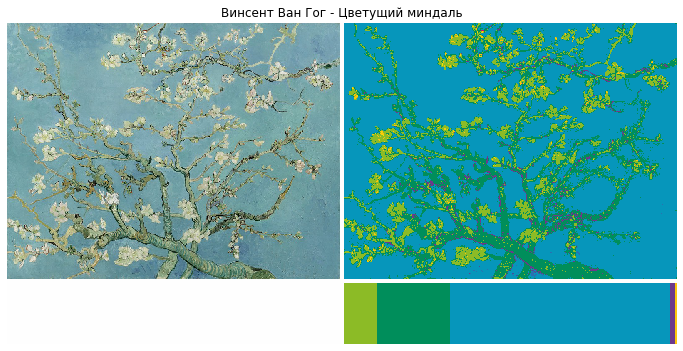

In [788]:
plot_composition_analysis(15679)

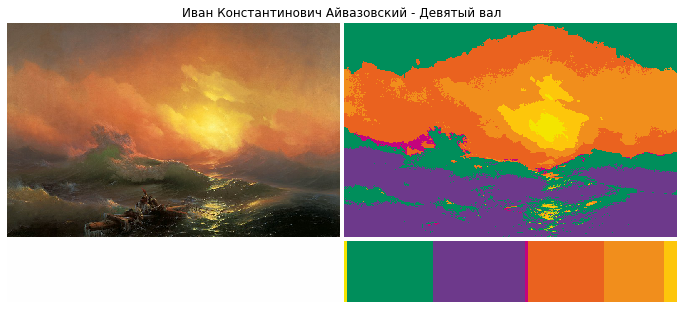

In [789]:
plot_composition_analysis(0)

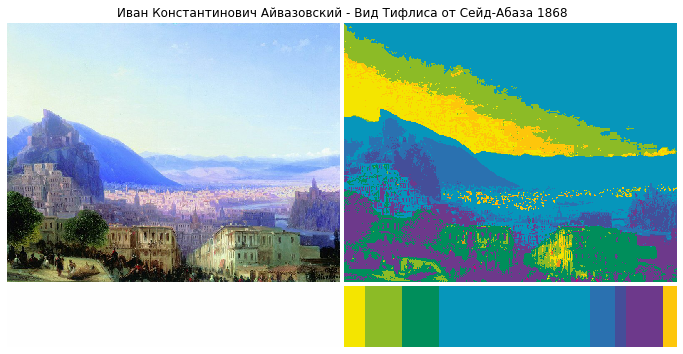

In [790]:
plot_composition_analysis(44)

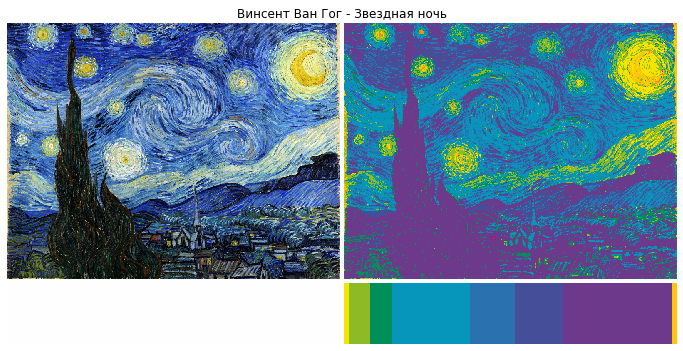

In [792]:
plot_composition_analysis(15678)

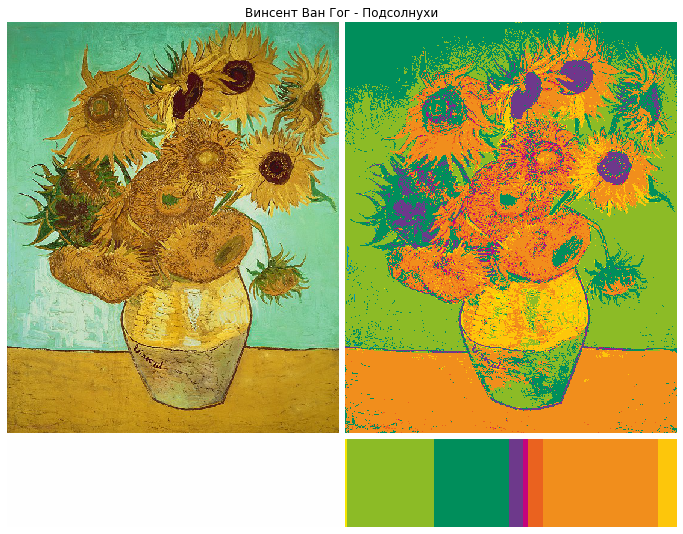

In [793]:
plot_composition_analysis(15681)

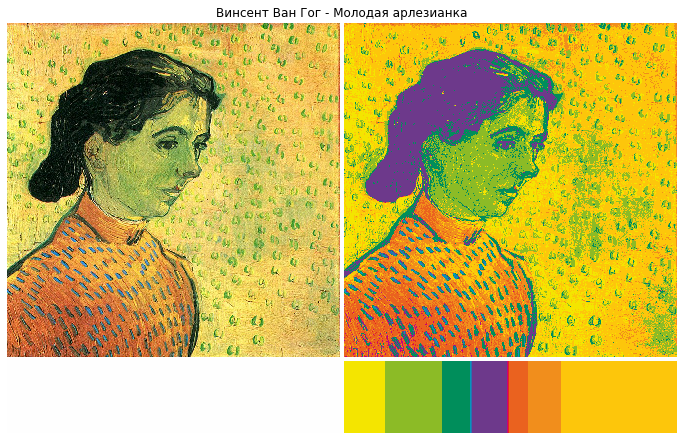

In [796]:
plot_composition_analysis(16391)

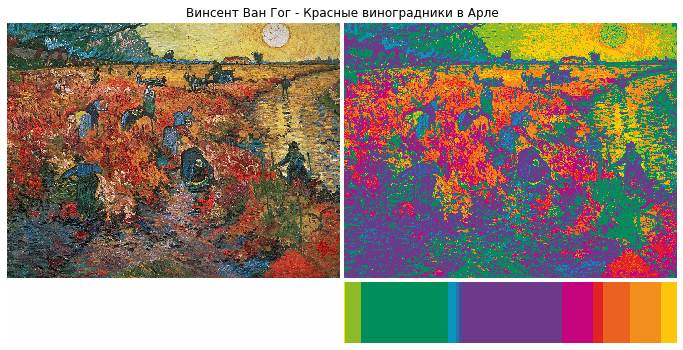

In [799]:
plot_composition_analysis(15694)

### Гармоничность картины может быть достигнута при использовании цветов, дополняющих друг друга определенным образом
Вариантов поиска цветовых решений на круге множество, в данной работе мы рассмотрим следующие:
* Комплиментарные цвета – сочетание основного и противоположного ему цвета
* Триады – сочетание 3-х цветов, равноудаленных друг по отношению другу.
* Квадраты – сочетание 4-х цветов, равноудаленных друг по отношению другу.

<img src="примеры.jpg" width="250" height="250">

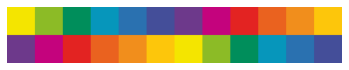

In [989]:
# Комплиментарые цвета
fig = plt.figure(constrained_layout=False)
img = np.vstack([
    np.hstack( [np.tile(c, (50,50,1)) for c in wheel_colors2]),
    np.hstack( [np.tile(c, (50,50,1)) for c in np.roll(wheel_colors2, 6,axis=0)])
])
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB),aspect = 'equal')
plt.axis('off');

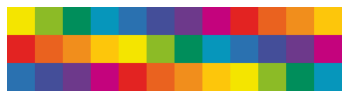

In [814]:
# Триады
fig = plt.figure(constrained_layout=False)
img = np.vstack([
    np.hstack( [np.tile(c, (50,50,1)) for c in wheel_colors2]),
    np.hstack( [np.tile(c, (50,50,1)) for c in np.roll(wheel_colors2, 4,axis=0)]),
    np.hstack( [np.tile(c, (50,50,1)) for c in np.roll(wheel_colors2, 8,axis=0)]),
])

plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB),aspect = 'equal')
plt.axis('off');

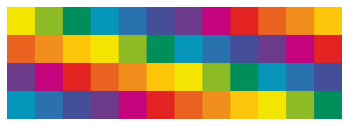

In [990]:
# квадраты
fig = plt.figure(constrained_layout=False)
img = np.vstack([
    np.hstack( [np.tile(c, (50,50,1)) for c in wheel_colors2]),
    np.hstack( [np.tile(c, (50,50,1)) for c in np.roll(wheel_colors2, 3,axis=0)]),
    np.hstack( [np.tile(c, (50,50,1)) for c in np.roll(wheel_colors2, 6,axis=0)]),
    np.hstack( [np.tile(c, (50,50,1)) for c in np.roll(wheel_colors2, 9,axis=0)]),
])

plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB),aspect = 'equal')
plt.axis('off');

In [1807]:
# вспомогательная функция для анализа изображения по цветовому кругу (сбор статистик)
def characterize_image(image_index):
    # загружаем изображение в luv формате
    luv_img = cv2.cvtColor(load_image_by_index(image_index), cv2.COLOR_BGR2LUV)
    # считаем евклидово расстояние до цветов цветового круга
    dist = euclidean_distances(luv_img.reshape(-1,3),wheel_colors_luv)
    # находим ближайшие цвета
    closest_colors = np.argmin(dist,axis=1)
    # считаем частоты появления цветов
    v, c = np.unique(closest_colors,return_counts=True)
    # нормируем
    c = c / c.sum()
    # сделаем массив с флагами есть/нет цвет
    _ = np.zeros((12), dtype=int)
    _[v]=1
    # сделаем массив с оценкой доли каждого цвета
    __ = np.zeros((12), dtype=int)
    # округлим до целых, избавимся от долей менее 1%
    __[_==1]=(c*100).astype(int)
    _[__==0]=0

    # сделаем статистику по распределению ошибки выбора цвета
    color_error_stat = pd.Series(dist.min(axis=1)).describe().values[1:].astype(int)

    # попробуем найти гармоничные наборы цветов
    # будем рассматривать цвета, перешедшие за порог 5%
    sp = set(np.argwhere((_==1) & (__>=5)).flatten())

    has_2 = 0
    has_2_unique = 0
    for row in np.vstack( [range(12), np.roll(range(12), 6,axis=0)]).T:
        sr = set(row)
        if sr.issubset(sp):
            has_2 = 1
            if sp == sr:
                has_2_unique = 1
                break

    has_3 = 0
    has_3_unique = 0
    for row in np.vstack( [range(12), 
                           np.roll(range(12), 4,axis=0), 
                           np.roll(range(12), 8,axis=0)]).T:
        sr = set(row)
        if sr.issubset(sp):
            has_3 = 1
            if sp == sr:
                has_3_unique = 1
                break            
    has_4 = 0
    has_4_unique = 0
    for row in np.vstack( [range(12), 
                           np.roll(range(12), 3,axis=0), 
                           np.roll(range(12), 6,axis=0),
                           np.roll(range(12), 9,axis=0)]).T:
        sr = set(row)
        if sr.issubset(sp):
            has_4 = 1
            if sp == sr:
                has_4_unique = 1
                break    

    complimentary_colors_stat = np.array([has_2, has_2_unique, has_3, has_3_unique, has_4, has_4_unique])            
    return np.hstack([__, color_error_stat, complimentary_colors_stat])

### Проанализируем все картины цветовому кругу
#### Получим:
* частоты цветов круга Иттена
* характеристики ошибок (насколько сильно реальные цвета отклоняются от опорных
* наличие гармогичных цветовых решений разного порядка и их интенсивность

In [1147]:
res = []
error = []
for img_index in tqdm(range(paintings_links.shape[0])):
# for img_index in tqdm(range(100)):
#     res.append(characterize_image(img_index))
    try:
#         bins, r, g, b = get_hist_data_by_index(img_index)
        res.append(characterize_image(img_index))
    except:
        res.append(np.zeros(25,))
        error.append(img_index)
        
images_stat = np.vstack(res)

In [1809]:
_=[]
for row in np.vstack( [range(12), np.roll(range(12), 6,axis=0)]).T:
    sr = set(row)
    _.append(images_stat[:,np.array(list(sr))].sum(axis=1).astype(int))
cmb2 = np.vstack(_).T.max(axis=1)
cmb2_leader = np.argmax(np.vstack(_).T,axis=1)

_=[]
for row in np.vstack( [range(12), 
                           np.roll(range(12), 4,axis=0), 
                           np.roll(range(12), 8,axis=0)]).T:
    sr = set(row)
    _.append(images_stat[:,np.array(list(sr))].sum(axis=1).astype(int))
cmb3 = np.vstack(_).T.max(axis=1)
cmb3_leader = np.argmax(np.vstack(_).T,axis=1)

_=[]
for row in np.vstack( [range(12), 
                           np.roll(range(12), 3,axis=0), 
                           np.roll(range(12), 6,axis=0),
                           np.roll(range(12), 9,axis=0)]).T:
    sr = set(row)
    _.append(images_stat[:,np.array(list(sr))].sum(axis=1).astype(int))
cmb4 = np.vstack(_).T.max(axis=1)
cmb4_leader = np.argmax(np.vstack(_).T,axis=1)

In [1895]:
_=[]
_std=[]
for row in np.vstack( [range(12), np.roll(range(12), 6,axis=0)]).T:
    sr = set(row)
    _.append(images_stat[:,np.array(list(sr))].sum(axis=1).astype(int))
    _std.append(images_stat[:,np.array(list(sr))].std(axis=1).astype(int))
cmb2 = np.vstack(_).T.max(axis=1)
cmb2_leader = np.argmax(np.vstack(_).T,axis=1)
cmb2_std = np.choose(cmb2_leader.T,np.vstack(_std))

_=[]
_std=[]
for row in np.vstack( [range(12), 
                           np.roll(range(12), 4,axis=0), 
                           np.roll(range(12), 8,axis=0)]).T:
    sr = set(row)
    _.append(images_stat[:,np.array(list(sr))].sum(axis=1).astype(int))
    _std.append(images_stat[:,np.array(list(sr))].std(axis=1).astype(int))
cmb3 = np.vstack(_).T.max(axis=1)
cmb3_leader = np.argmax(np.vstack(_).T,axis=1)
cmb3_std = np.choose(cmb3_leader.T,np.vstack(_std))

_=[]
_std=[]
for row in np.vstack( [range(12), 
                           np.roll(range(12), 3,axis=0), 
                           np.roll(range(12), 6,axis=0),
                           np.roll(range(12), 9,axis=0)]).T:
    sr = set(row)
    _.append(images_stat[:,np.array(list(sr))].sum(axis=1).astype(int))
    _std.append(images_stat[:,np.array(list(sr))].std(axis=1).astype(int))
cmb4 = np.vstack(_).T.max(axis=1)
cmb4_leader = np.argmax(np.vstack(_).T,axis=1)
cmb4_std = np.choose(cmb4_leader.T,np.vstack(_std))


# Посмотрими на примеры композиционных решений

In [1923]:
# вспомогательная функция для визуализации композиционного решения
def plot_composition_analysis2(image_index, print_index=False):

    img = load_image_by_index(image_index)
    luv_img = cv2.cvtColor(load_image_by_index(image_index), cv2.COLOR_BGR2LUV)
    closest_colors = np.argmin(euclidean_distances(luv_img.reshape(-1,3),wheel_colors_luv),axis=1)
    wheel_colors2[closest_colors].reshape(luv_img.shape)
    color_areas_img = wheel_colors2[closest_colors].reshape(img.shape)

    v, c = get_image_colors(image_index)
    # переведем в целочисленные значения и отмасштабируем по ширине картины
    c_int = (c*img.shape[1]).astype(int)
    c_int_delta = img.shape[1] - sum(c_int)
    c_int[np.argmax(c_int)] = c_int[np.argmax(c_int)] + c_int_delta

    _ = []

    for i, vi in enumerate(v):
        bar_width = c_int[i]
        _.append(np.tile(wheel_colors2[vi], (150,bar_width,1)))
    color_bar_img = np.hstack(_)
    final_image = np.hstack([
                                np.vstack([img,
                                           np.tile(np.array([254,254,254]),(160,img.shape[1],1))]),

                                np.tile(np.array([254,254,254]),(img.shape[0]+160,10,1)),
                                np.vstack([color_areas_img,
                                           np.tile(np.array([254,254,254]),(10,img.shape[1],1)),
                                           color_bar_img])
                            ])

    np_wheel = cv2.resize(wheel[:,:,:], dsize=(final_image.shape[0], final_image.shape[0]), interpolation=cv2.INTER_NEAREST)
    np_wheel[np_wheel[:,:,3]==0] = np.array([254,254,254,0])

    final_final_image = np.hstack([final_image, 
                   np.tile(np.array([254,254,254]),(final_image.shape[0],10,1)),
                   np_wheel[:,:,:3]]).astype(np.uint8)

    h = 14
    w = h / final_final_image.shape[1] * final_final_image.shape[0]
    fig = plt.figure(figsize=(h,w))
    

    if print_index:
        plt.title("{} - {} ({})".format(paintings_links.iloc[image_index].artist_name, 
                                        paintings_links.iloc[image_index].picture_name,
                                        image_index),ha= "center")
    else:

        plt.title("{} - {}".format(paintings_links.iloc[image_index].artist_name, 
                                        paintings_links.iloc[image_index].picture_name),ha= "center")        


    # загрузим метаданные об изображении выберем самый сильный композиционный элемент для отображения на круге
    image_data = images_stat_df.loc[image_index]
    if image_data.most_imp==2:
        cases = np.vstack( [range(12), np.roll(range(12), 6,axis=0)]).T
        selected_colors = cases[cases[:,0]==image_data.cmb2_leader].flatten()
    if image_data.most_imp==3:
        cases = np.vstack( [range(12), 
                               np.roll(range(12), 4,axis=0), 
                               np.roll(range(12), 8,axis=0)]).T
        selected_colors = cases[cases[:,0]==image_data.cmb3_leader].flatten()
    if image_data.most_imp==4:
        cases = np.vstack( [range(12), 
                               np.roll(range(12), 3,axis=0), 
                               np.roll(range(12), 6,axis=0),
                               np.roll(range(12), 9,axis=0)]).T
        selected_colors = cases[cases[:,0]==image_data.cmb4_leader].flatten() 


    plt.imshow(cv2.cvtColor(
        final_final_image, 
        cv2.COLOR_BGR2RGB),
               zorder=0,
              )


    # рассчитаем координаты для каждого элемента цветового круга
    x=0
    y= int(final_final_image.shape[0]*0.8*0.5)
    theta = np.deg2rad([_ for _ in range(0,360,30)]);
    cs = np.cos(theta);
    sn = np.sin(theta);
    px = x * cs - y * sn; 
    py = x * sn + y * cs;
    wheel_coords = np.vstack([px,py]).astype(int).T
    
    # найдем центр круга, он будет нашей точкой отсчета
    color_wheel_center = (final_final_image.shape[1] - final_final_image.shape[0]//2) , final_final_image.shape[0]//2
    wheel_coords[:,0] = wheel_coords[:,0] + color_wheel_center[0]
    wheel_coords[:,1] =  - wheel_coords[:,1] + color_wheel_center[1]
  
    ax =plt.gca()
    verticles = wheel_coords[selected_colors]
    for i in verticles:
        circle1 = plt.Circle((i[0], i[1]), 20, color='grey', fill=True, linewidth=4)
        ax.add_artist(circle1)
    ax.add_artist(plt.Polygon(verticles, True, color = "grey", fill=False, linewidth=4))
    plt.axis('off');
    plt.show()


In [1952]:
# художники, которых я не хотел бы видеть в этой части анализа
painters_bl = ["Елизавета Меркурьевна Бём (Эндаурова)","Fisher, Harrison \xa0",
               "Джил Элвгрен","Driben, Peter \xa0","Armstrong, Rolf \xa0",
               "Parkinson, Keith \xa0","Amano, Yoshitaka \xa0",
               "Muth, John J \xa0","Nagel, Patrick \xa0", "Girotto, Walter \xa0"]
images_stat_df = pd.concat([paintings_links, 
                            pd.DataFrame(images_stat),
                            pd.Series(cmb2, name="cmb2"),
                            pd.Series(cmb2_leader, name="cmb2_leader"),
                            pd.Series(cmb2_std, name="cmb2_std"),
                            pd.Series(cmb3, name="cmb3"),
                            pd.Series(cmb3_leader, name="cmb3_leader"),
                            pd.Series(cmb3_std, name="cmb3_std"),
                            pd.Series(cmb4, name="cmb4"),
                            pd.Series(cmb4_leader, name="cmb4_leader"),
                            pd.Series(cmb4_std, name="cmb4_std"),
                           ],axis=1)
images_stat_df["most_imp"] = np.argmax([images_stat_df.cmb2, images_stat_df.cmb3,images_stat_df.cmb4],axis=0)+2
# images_stat_df = images_stat_df[~images_stat_df.artist_name.isin(painters_bl)].copy()

In [1897]:
images_stat_df.most_imp.value_counts()

3    33528
4    11692
2      999
Name: most_imp, dtype: int64

In [2062]:
# for main_color in range(0,12):
#     for i in images_stat_df[
#         (images_stat_df.most_imp==2)
#         & (~images_stat_df.artist_name.isin(painters_bl))
#         & (images_stat_df.cmb2>30)
#         & (images_stat_df.cmb2_leader==main_color)
#     ].sort_values(by="cmb2_std",ascending=False).head(5).index.values:
#         plot_composition_analysis2(i, print_index=True)
        

## комплиментарные цвета и гармоничные объемы

In [2098]:
# for main_color in range(0,12):
#     for i in images_stat_df[
#         (images_stat_df.most_imp==2)
#         & (~images_stat_df.artist_name.isin(painters_bl))
#         & (images_stat_df.cmb2>30)
#         & (images_stat_df.cmb2_leader==main_color)
#     ].sort_values(by="cmb2_std",ascending=True).head(5).index.values:
#         plot_composition_analysis2(i, print_index=True)
        

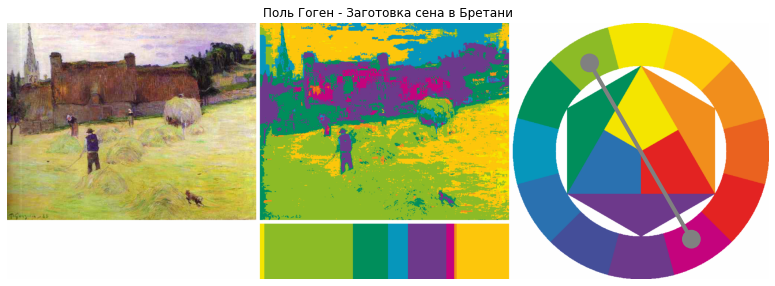

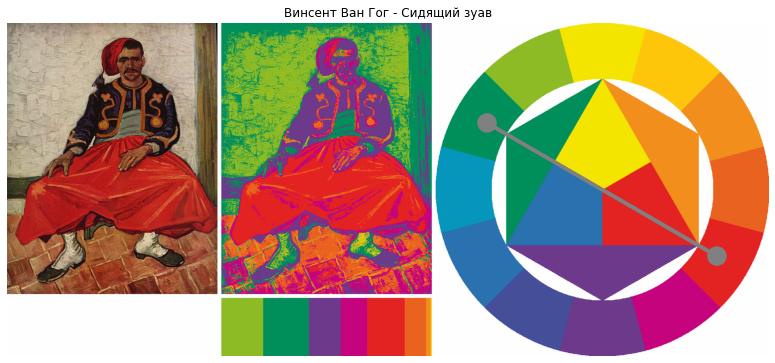

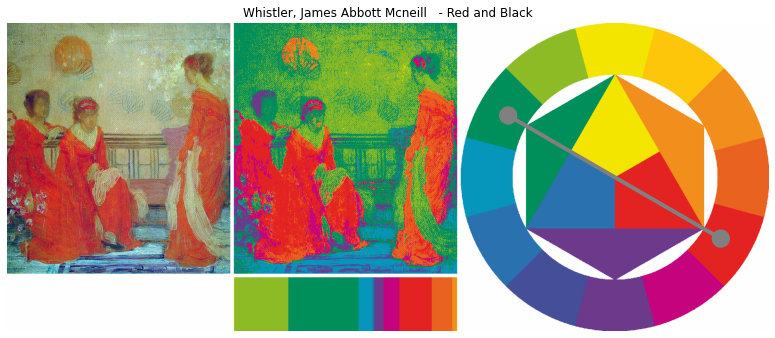

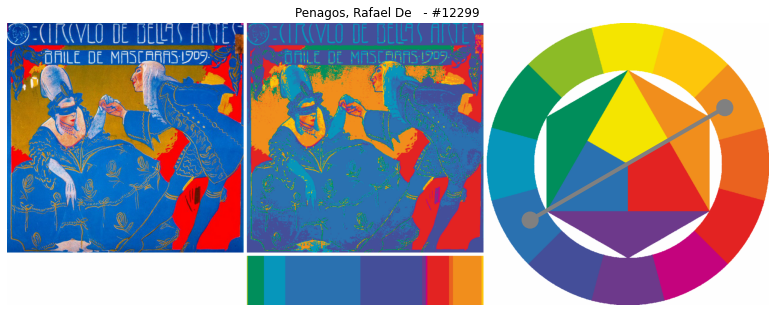

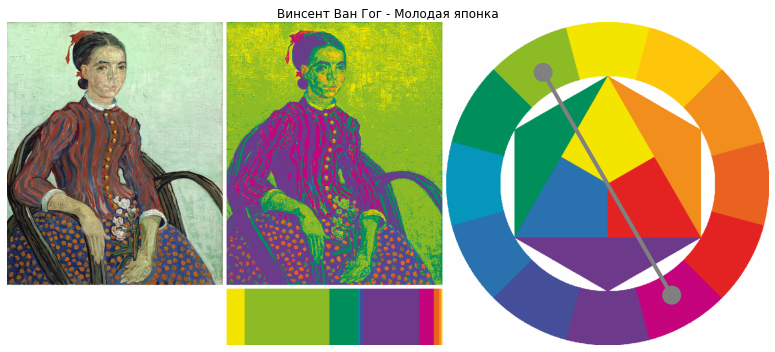

In [2066]:
for i in [14888,16119,45837,31386,15898]:
    plot_composition_analysis2(i, print_index=False)

## триады и контрастные объемы

In [2067]:
# for main_color in range(0,12):
#     for i in images_stat_df[
#         (images_stat_df.most_imp==3)
#         & (~images_stat_df.artist_name.isin(painters_bl))
#         & (images_stat_df.cmb3>30)
#         & (images_stat_df.cmb3_leader==main_color)
#     ].sort_values(by="cmb3_std",ascending=False).head(5).index.values:
#         plot_composition_analysis2(i, print_index=True)
        

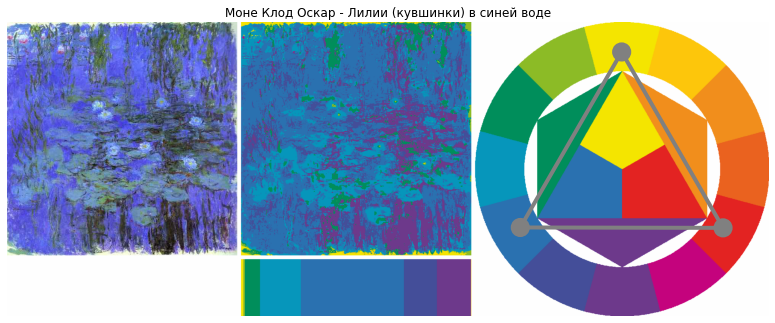

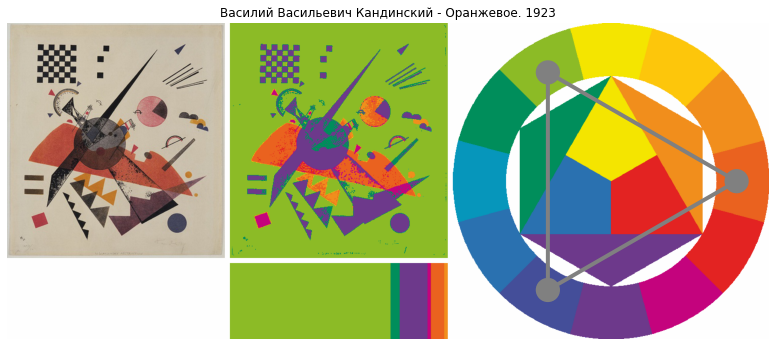

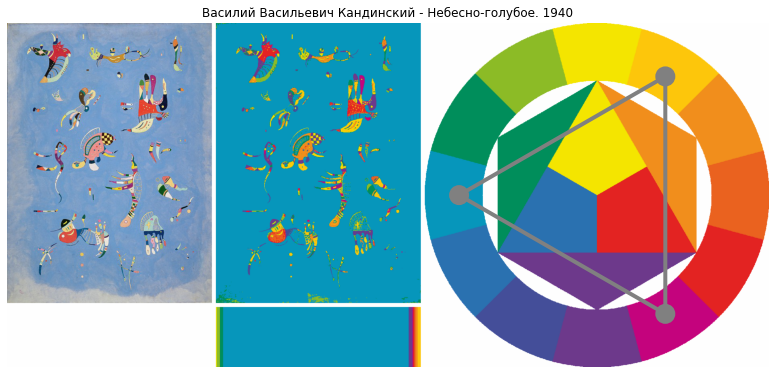

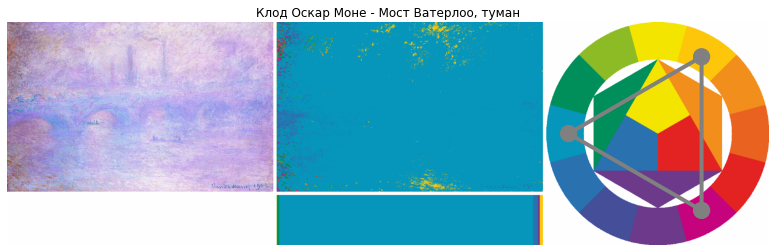

In [2068]:
for i in [26504,47555,47470,26995]:
    plot_composition_analysis2(i, print_index=False)

## триады и гармоничные объемы

In [2069]:
# for main_color in range(0,12):
#     for i in images_stat_df[
#         (images_stat_df.most_imp==3)
#         & (~images_stat_df.artist_name.isin(painters_bl))
#         & (images_stat_df.cmb3>30)
#         & (images_stat_df.cmb3_leader==main_color)
#     ].sort_values(by="cmb3_std",ascending=True).head(5).index.values:
#         plot_composition_analysis2(i, print_index=True)
        

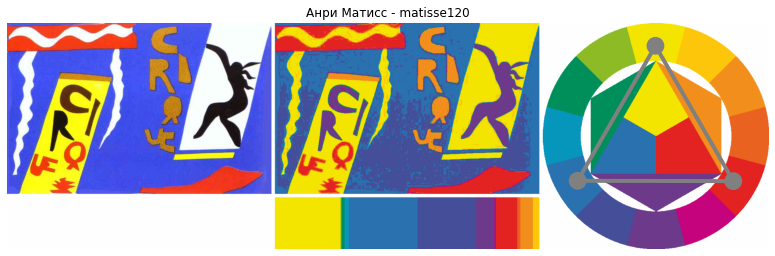

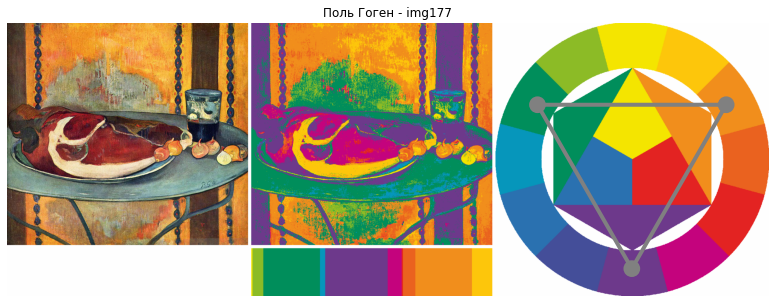

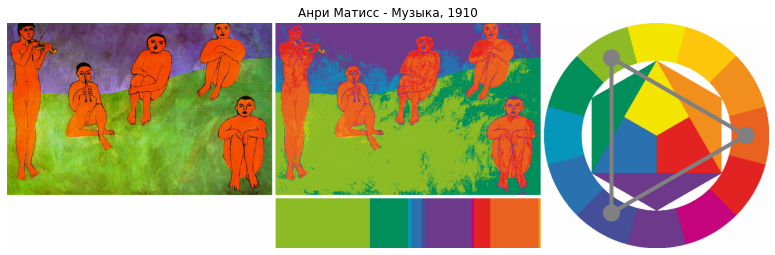

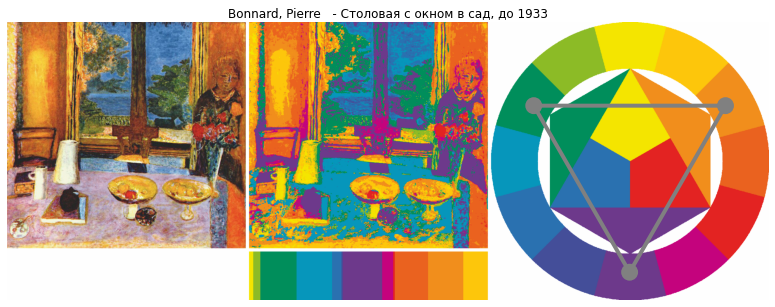

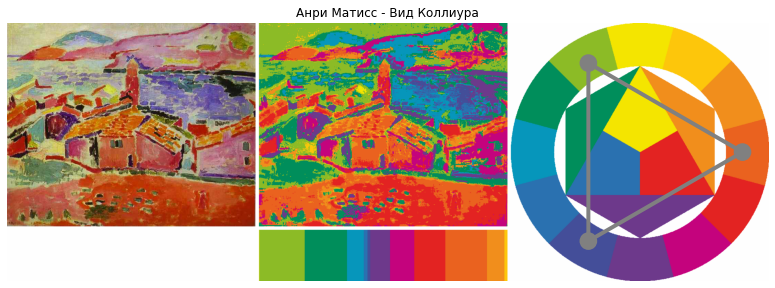

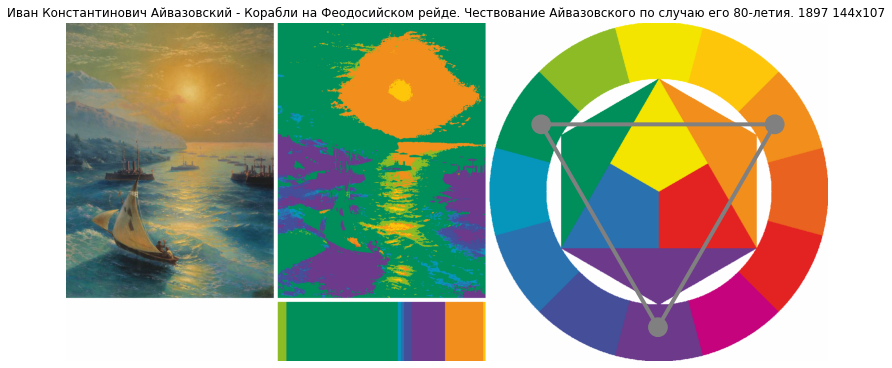

In [2080]:
for i in [25611,14829,25487,3784,25604,16]:
    plot_composition_analysis2(i, print_index=False)

## квадраты и контраснтные объемы

In [2072]:
# for main_color in range(0,12):
#     for i in images_stat_df[
#         (images_stat_df.most_imp==4)
#         & (~images_stat_df.artist_name.isin(painters_bl))
#         & (images_stat_df.cmb4>30)
#         & (images_stat_df.cmb4_leader==main_color)
#     ].sort_values(by="cmb4_std",ascending=False).head(30).index.values:
#         plot_composition_analysis2(i, print_index=True)
        

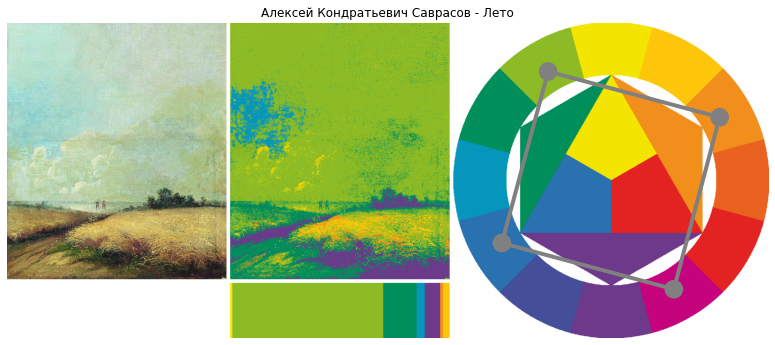

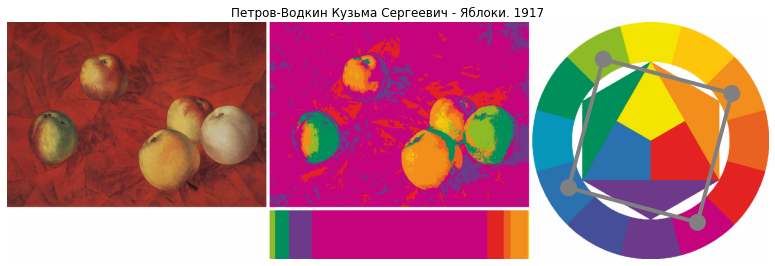

In [2073]:
for i in [39817,31847]:
    plot_composition_analysis2(i, print_index=False)

## квадраты и гармоничные объемы

In [2074]:
# for main_color in range(0,12):
#     for i in images_stat_df[
#         (images_stat_df.most_imp==4)
#         & (~images_stat_df.artist_name.isin(painters_bl))
#         & (images_stat_df.cmb4>30)
#         & (images_stat_df.cmb4_leader==main_color)
#     ].sort_values(by="cmb4_std",ascending=True).head(5).index.values:
#         plot_composition_analysis2(i, print_index=True)
        

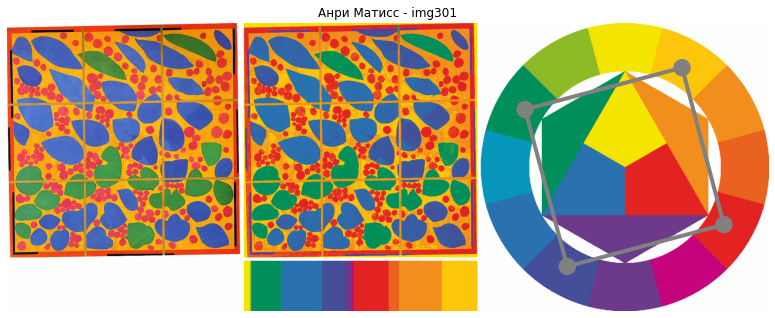

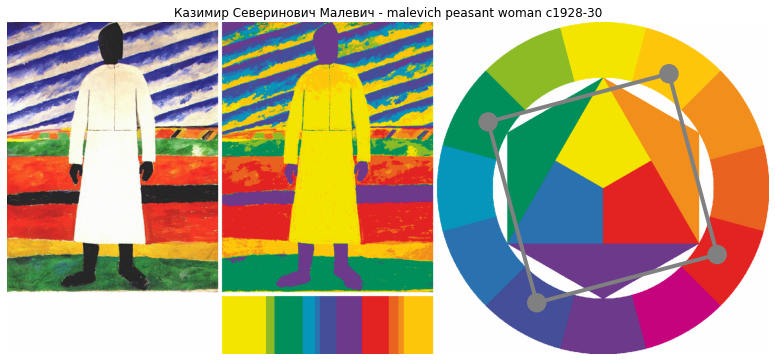

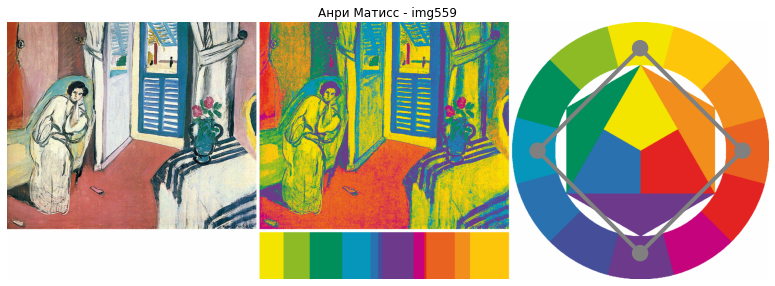

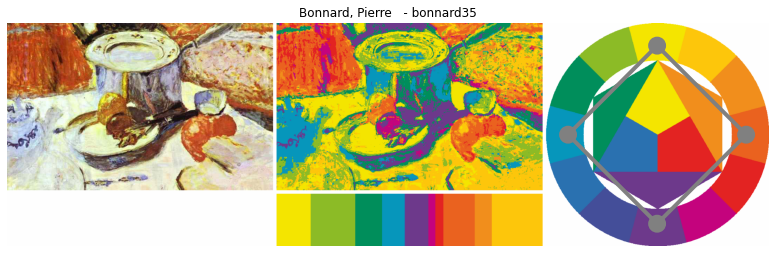

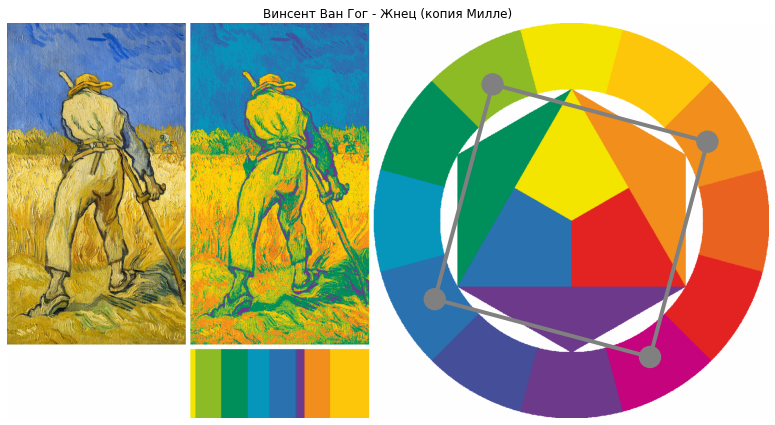

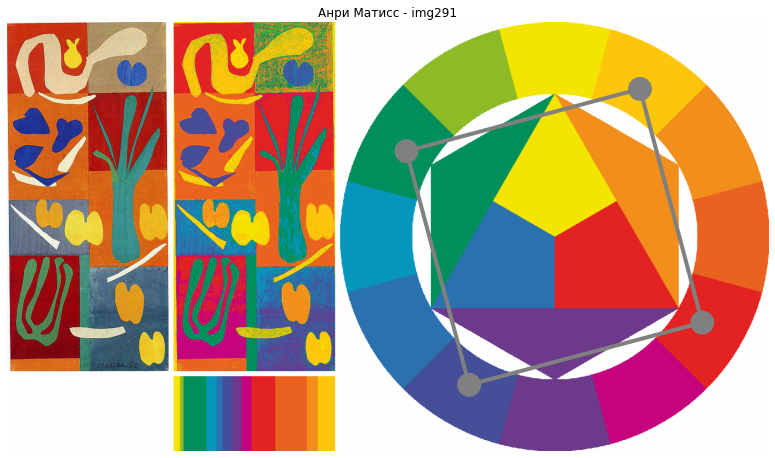

In [2078]:
for i in [25706, 48304, 25692,3874,15761,25553]:
    plot_composition_analysis2(i, print_index=False)


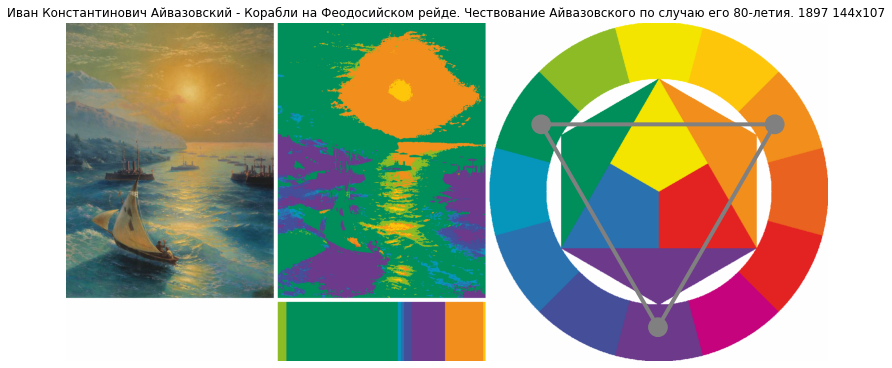

### построим модель, опираясь только на данные цветового круга. Будет ли такая модель иметь предсказательную силу?

In [1954]:
%%time
temp_df = images_stat_df.iloc[:,7:]
temp_x_train =   temp_df[temp_df.index.isin(X_train.index.values)]
temp_x_test =   temp_df[temp_df.index.isin(X_test.index.values)]
xgb=XGBClassifier()
xgb.fit(temp_x_train, y_train)

Wall time: 21min 27s


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='multi:softprob', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [1959]:
%%time
current_res = classification_report(y_test, xgb.predict(temp_x_test), labels=None, target_names=None, output_dict=True)
model_stat = pd.DataFrame(current_res).drop(columns=["accuracy","macro avg","weighted avg"]).T
model_stat["artist_name"] = le.classes_
model_stat.sort_values(by="f1-score").tail(10)

Wall time: 1min 26s


,precision,recall,f1-score,support,artist_name
46,0.043478,0.012195,0.019048,82.0,"Martin, Henri-Jean-Guillaume"
162,0.032680,0.029070,0.030769,172.0,Камиль Писсарро
153,0.166667,0.019608,0.035088,51.0,Жан-Леон Жером
91,0.111111,0.023256,0.038462,43.0,Unknown painters
89,0.076923,0.027778,0.040816,36.0,"Turner, Joseph Mallord William"
69,0.133333,0.024390,0.041237,82.0,"Poortvliet, Rien"
173,0.100000,0.026316,0.041667,38.0,Макс Клингер
190,0.026725,0.228216,0.047847,241.0,Пьер Огюст Ренуар
9,0.200000,0.028571,0.050000,35.0,"Brasilier, Andre"
166,0.028745,0.639098,0.055016,266.0,Клод Оскар Моне


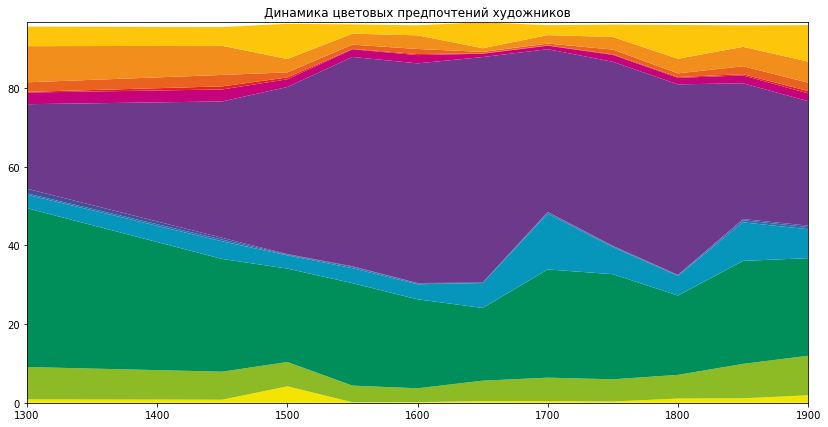

In [2055]:
_ = images_stat_df[~images_stat_df.artist_name.isin(painters_bl)].iloc[:,7:19]
_["live_from"] = images_stat_df.live_from.astype(int)
_["period"] = (_.live_from//50 +1 )*50
data_to_plot = _[_.period>50].groupby(by="period").mean()
# data_to_plot.iloc[:,:12] =data_to_plot.iloc[:,:12] / data_to_plot.iloc[:,:12].sum(axis=1)
# Make the plot
fig = plt.figure(figsize=(14,7))
plt.stackplot(data_to_plot.index.values,data_to_plot.iloc[:,:12].values.T, colors=(wheel_colors2[:,[2,1,0]]/255))
plt.margins(0,0)
plt.title('Динамика цветовых предпочтений художников')
plt.show()

## тема очень многогранная, вариантов анализа очень много. 
### как можно продолжить:
* проанализировать другие варианты гармоничных комбинаций цветовом круге (прямоугольники, равнобедренные треугольники, соседи по кругу)
* посмотреть кто-как часто использует эти комбинации. были ли они всегда и Иттен Иоганнес их просто описал или их начали активно использовать после него
* найти работы, чье авторство под сомнением и посмотреть, что моделька определит
* попробовать не просто цвета считать, а искать крупные цветовые пятна на картине

In [2094]:
# images_stat_df[images_stat_df.artist_name.str.lower().str.contains("мунк")]

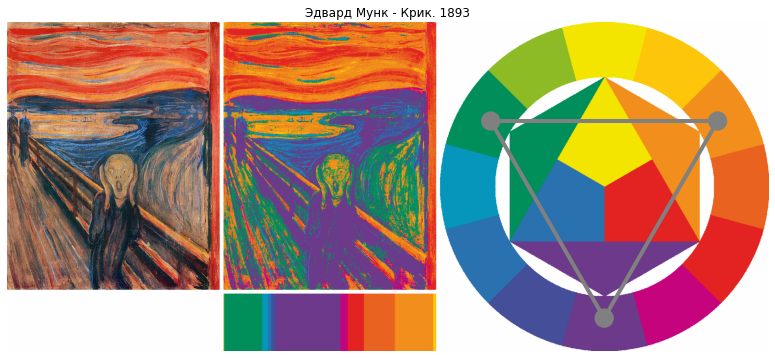

In [2099]:
plot_composition_analysis2(29021, print_index=False)